In [1]:
import sys
import importlib
import gc
import glob
import random

from itertools import combinations

import numpy as np
import scipy
import sklearn
from sklearn import metrics

import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import ticker
import seaborn as sns

import pyemma
import msmtools
import mdtraj as md

import ivac
import extq

In [2]:
sys.path.insert(1, "../../python")
sys.path.insert(1, "../../..")
import util
import plotting

In [3]:
import MDAnalysis as mda
from MDAnalysis.analysis.hydrogenbonds import HydrogenBondAnalysis
from scipy import signal

/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")


In [4]:
plt.style.use("custom")  # custom style sheet
plt.style.use("muted")  # muted color theme from SciencePlots

cm_seq = sns.cubehelix_palette(
    start=0, rot=-0.70, gamma=0.40, light=0.9, dark=0.1, as_cmap=True, reverse=True
)
colors = mpl.colors.to_rgba_array(
    [
        "#364B9A",
        "#4A7BB7",
        "#6EA6CD",
        "#98CAE1",
        "#C2E4EF",
        "#EAECCC",
        "#FEDA8B",
        "#FDB366",
        "#F67E4B",
        "#DD3D2D",
        "#A50026",
    ]
)
cm_div = mpl.colors.LinearSegmentedColormap.from_list("", colors)

In [5]:
def moving_average(x, w):
    return signal.convolve(x, np.ones(w) / w, mode='same')

In [6]:
from joblib import Parallel, delayed
from multiprocessing import cpu_count
n_jobs = cpu_count()

In [23]:
files = []
remove = {1282,
    1283,
    1284,
    1285,
    1286,
    1288,
    1289,
    1290,
    1187,
    1188,
    1189,
    1190,
    1191,
    1197,
    1198,
    1199,
    1203,
    1205,
    1206,
    1207,
    1211,
    1212,
    1213,
    1214,
    1215,
    1225,
    1226,
    1227,
    1228,
    1231,
    1232,
    1233,
    1236,
    1237,
    1238,
    1242,
    1245,
    1246,
    1252,
    1253,
    1260,
    1261,
    1262,
    1263,
    1266,
    1267,
    1268,
    1269,
    1270,
    1271,
    1272,
    1273,
    1274,
    1275,
    1276,
    1277,
    1278,
    1279,
}
for i in range(295):
    if (i + 1000) not in remove:
        files.append(f"/project/dinner/scguo/anton-old/xtc1000ns/civsd-{i}.xtc")
for i in range(3, 63):
    files.append(f"/project/dinner/scguo/ci-vsd/anton2/prot/civsd.prot.{i}.xtc")

In [7]:
topfile = "/project/dinner/scguo/ci-vsd/civsd-pro.psf"

In [7]:
u = mda.Universe(topfile, files[0])

NameError: name 'files' is not defined

In [18]:
ri = 226
sel1 = f"protein and resid {ri} and name NE NH1 NH2"
sel2 = "protein and resid 129 183 186 and name OD1 OD2 OE1 OE2"
for a in u.select_atoms(sel1):
    print(a)
for a in u.select_atoms(sel2):
    print(a)

<Atom 1946: NE of type NC2 of resname ARG, resid 226 and segid A>
<Atom 1949: NH1 of type NC2 of resname ARG, resid 226 and segid A>
<Atom 1952: NH2 of type NC2 of resname ARG, resid 226 and segid A>
<Atom 413: OD1 of type OC of resname ASP, resid 129 and segid A>
<Atom 414: OD2 of type OC of resname ASP, resid 129 and segid A>
<Atom 1268: OE1 of type OC of resname GLU, resid 183 and segid A>
<Atom 1269: OE2 of type OC of resname GLU, resid 183 and segid A>
<Atom 1306: OD1 of type OC of resname ASP, resid 186 and segid A>
<Atom 1307: OD2 of type OC of resname ASP, resid 186 and segid A>


In [19]:
hbonds = HydrogenBondAnalysis(
    universe=u,
    donors_sel=sel1,
    acceptors_sel=sel2)
hbonds.run()

In [23]:
plt.rcParams['text.usetex'] = False

[['ARG:NC2' 'ASP:OC' '7670']]
[[1945 1946 1306 2391]
 [1945 1946 1305 1974]
 [1951 1953 1305 1722]
 [1951 1953 1306 1491]
 [1948 1950  412   79]
 [1951 1952 1306    2]
 [1951 1952 1305    2]
 [1948 1950  413    2]
 [1948 1949 1306    2]
 [1948 1949 1305    2]
 [1951 1952  413    1]
 [1951 1952  412    1]
 [1948 1949  412    1]]


/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:662: DeprecationWarning: The `hbonds` attribute was deprecated in MDAnalysis 2.0.0 and will be removed in MDAnalysis 3.0.0. Please use `results.hbonds` instead.
  warnings.warn(wmsg, DeprecationWarning)


findfont: Font family ['"Computer Modern Sans Serif"'] not found. Falling back to DejaVu Sans.


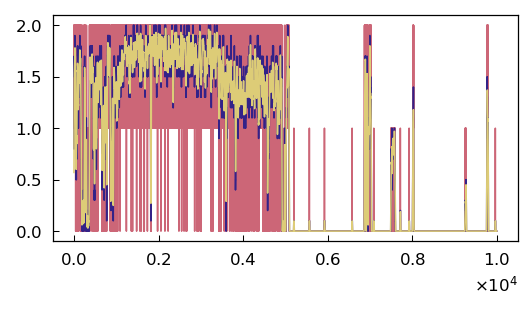

In [24]:
print(hbonds.count_by_type())
print(hbonds.count_by_ids())

f = plt.figure(figsize=(4, 2))
hb_time = hbonds.count_by_time()
plt.plot(hb_time)
plt.plot(moving_average(hb_time, 10))
plt.plot(moving_average(moving_average(hb_time, 10), 10))
# plt.xlim([0, 500])

# Parallel

In [8]:
def hbond_traj(trajfile, sel1, sel2):
    u = mda.Universe(topfile, trajfile)
    hbonds = HydrogenBondAnalysis(
        universe=u, 
        donors_sel=sel1, 
        hydrogens_sel=None, 
        acceptors_sel=sel2,
        update_selections=False)
    return hbonds

def run_analysis(analysis):
    analysis.run()
    return analysis

In [10]:
all_analyses = []
# for i in (217, 223, 226, 229, 232):
#     for j in (129, 183, 186):
#         sel1 = f"protein and resid {i} and name NE NH1 NH2"
#         sel2 = f"protein and resid {j} and name OD1 OD2 OE1 OE2"
sel1 = f"protein and resid 217 223 226 229 232 and name NE NH1 NH2"
sel2 = f"protein and resid 129 183 186 and name OD1 OD2 OE1 OE2"
all_analyses = [hbond_traj(f, sel1, sel2) for f in files]

NameError: name 'files' is not defined

In [35]:
print(len(all_analyses))

297


In [40]:
results_all = Parallel(n_jobs=n_jobs, verbose=40)(
    delayed(run_analysis)(analysis) for analysis in all_analyses)

[Parallel(n_jobs=48)]: Using backend LokyBackend with 48 concurrent workers.
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. 

In [49]:
results_all[0].results['hbonds'].shape

(23422, 6)

In [51]:
len(results_all[0].frames)

10000

In [70]:
dic = {}
for (i, j, k, num) in results_all[0].count_by_ids():
    d_id = u.atoms[i].resid
    a_id = u.atoms[k].resid
    print(f"Donor: {d_id}, Acceptor: {a_id}, Count: {num}")
    key = (d_id, a_id)
    if key not in dic.keys():
        dic[key] = {(i, k)} # atom id
    else:
        dic[key].add((i, k))

Donor: 223, Acceptor: 129, Count: 2676
Donor: 229, Acceptor: 186, Count: 2511
Donor: 223, Acceptor: 129, Count: 2489
Donor: 229, Acceptor: 186, Count: 2410
Donor: 226, Acceptor: 186, Count: 2391
Donor: 226, Acceptor: 186, Count: 1974
Donor: 223, Acceptor: 129, Count: 1854
Donor: 226, Acceptor: 186, Count: 1722
Donor: 229, Acceptor: 186, Count: 1493
Donor: 226, Acceptor: 186, Count: 1491
Donor: 223, Acceptor: 129, Count: 1270
Donor: 229, Acceptor: 186, Count: 1021
Donor: 226, Acceptor: 129, Count: 79
Donor: 229, Acceptor: 183, Count: 14
Donor: 229, Acceptor: 183, Count: 3
Donor: 229, Acceptor: 183, Count: 3
Donor: 223, Acceptor: 129, Count: 3
Donor: 226, Acceptor: 186, Count: 2
Donor: 226, Acceptor: 129, Count: 2
Donor: 226, Acceptor: 186, Count: 2
Donor: 226, Acceptor: 186, Count: 2
Donor: 226, Acceptor: 186, Count: 2
Donor: 229, Acceptor: 183, Count: 2
Donor: 223, Acceptor: 129, Count: 1
Donor: 229, Acceptor: 183, Count: 1
Donor: 226, Acceptor: 129, Count: 1
Donor: 226, Acceptor: 129,

/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/analysis/hydrogenbonds/hbond_analysis.py:662: DeprecationWarning: The `hbonds` attribute was deprecated in MDAnalysis 2.0.0 and will be removed in MDAnalysis 3.0.0. Please use `results.hbonds` instead.
  warnings.warn(wmsg, DeprecationWarning)


In [71]:
dic

{(223, 129): {(1883, 412), (1883, 413), (1889, 412), (1889, 413)},
 (229, 186): {(2001, 1305), (2001, 1306), (2007, 1305), (2007, 1306)},
 (226, 186): {(1945, 1305),
  (1945, 1306),
  (1948, 1305),
  (1948, 1306),
  (1951, 1305),
  (1951, 1306)},
 (226, 129): {(1948, 412), (1948, 413), (1951, 412), (1951, 413)},
 (229, 183): {(2004, 1267), (2004, 1268), (2007, 1267), (2007, 1268)}}

In [15]:
arrs = []
# array goes R217-D129, R217-D183, R217-D186, R223-D129, ..., R232-D186
index_dic = {}
hb_labels = []
for i, r in enumerate((217, 223, 226, 229, 232)):
    for j, d in enumerate((129, 183, 186)):
        index_dic[(r, d)] = i * 3 + j
for r in ('R217', 'R223', 'R226', 'R229', 'R232'):
    for d in ('D129', 'E183', 'D186'):
        hb_labels.append(f'{r}-{d}')

In [102]:
for i in results_all[:1]:
    result = i.results.hbonds
    t_len = len(i.frames)
    arr = np.zeros((t_len, 18), dtype=int)
    for (frame, d_id, h_id, a_id, dist, angle) in result:
        d_resid = u.atoms[int(d_id)].resid
        a_resid = u.atoms[int(a_id)].resid
        y = index_dic[(d_resid, a_resid)]
        print((d_resid, a_resid))
        arr[int(frame), y] += 1
    arrs.append(arr)

(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(223, 129)
(223, 129)
(226, 186)
(226, 186)
(223, 129)

In [100]:
print(results_all[0].results.hbonds)

[[0.00000000e+00 1.88300000e+03 1.88400000e+03 4.13000000e+02
  2.75159978e+00 1.54978496e+02]
 [0.00000000e+00 1.88900000e+03 1.89100000e+03 4.12000000e+02
  2.91015468e+00 1.59271646e+02]
 [0.00000000e+00 1.94500000e+03 1.94600000e+03 1.30600000e+03
  2.77866910e+00 1.74758625e+02]
 ...
 [9.99800000e+03 2.00100000e+03 2.00200000e+03 1.30500000e+03
  2.76488715e+00 1.72708346e+02]
 [9.99800000e+03 2.00700000e+03 2.00900000e+03 1.30600000e+03
  2.75421245e+00 1.63935686e+02]
 [9.99900000e+03 2.00100000e+03 2.00200000e+03 1.30500000e+03
  2.79589244e+00 1.77608956e+02]]


In [94]:
len(arrs), arrs[-1].shape

(297, (10001, 18))

Text(0, 0.5, 'R226-D186')

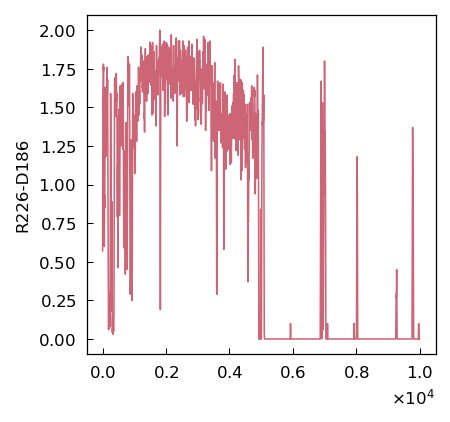

In [107]:
k = 8
plt.plot(moving_average(moving_average(arrs[0][:, k], 10), 10))
plt.ylabel(hb_labels[k])

In [108]:
np.save("../../data/raw_feat/hbonds.npy", arrs[:237])
np.save("../../data/raw_feat/hbonds_anton2.npy", arrs[237:])

/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


## New trajectories 3.25.22

In [9]:
xtc_files = []
for i in range(83, 119):
    xtc_files.append(f"/project/dinner/scguo/ci-vsd/anton2/prot/civsd.prot.{i}.xtc")

In [10]:
sel1 = f"protein and resid 217 223 226 229 232 and name NE NH1 NH2"
sel2 = f"protein and resid 129 183 186 and name OD1 OD2 OE1 OE2"
all_analyses = [hbond_traj(f, sel1, sel2) for f in xtc_files]

In [11]:
results_all = Parallel(n_jobs=n_jobs, verbose=40)(
    delayed(run_analysis)(analysis) for analysis in all_analyses)

[Parallel(n_jobs=48)]: Using backend LokyBackend with 48 concurrent workers.
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. 

In [12]:
u = mda.Universe(topfile, xtc_files[0])

In [16]:
arrs = []
for i in results_all:
    result = i.results.hbonds
    t_len = len(i.frames)
    arr = np.zeros((t_len, 18), dtype=int)
    for (frame, d_id, h_id, a_id, dist, angle) in result:
        d_resid = u.atoms[int(d_id)].resid
        a_resid = u.atoms[int(a_id)].resid
        y = index_dic[(d_resid, a_resid)]
        print((d_resid, a_resid))
        arr[int(frame), y] += 1
    arrs.append(arr)

(223, 129)
(223, 129)
(223, 129)
(223, 129)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(223, 129)
(223, 129)
(229, 186)
(229, 186)
(223, 129)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(223, 129)
(229, 186)
(229, 186)
(223, 129)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(223, 129)
(229, 186)
(229, 186)
(229, 186)
(223, 129)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(229, 186)

In [17]:
len(arrs), arrs[0].shape

(36, (10001, 18))

In [18]:
arrs_old = list(np.load("../../data/raw_feat/hbonds.npy", allow_pickle=True))
arrs_anton2 = list(np.load("../../data/raw_feat/hbonds_anton2.npy", allow_pickle=True))
print(len(arrs_old), len(arrs_anton2))

237 79


In [19]:
arrs_anton2.extend(arrs)

In [20]:
print(len(arrs_anton2))

115


In [70]:
np.save("../../data/raw_feat/hbonds_anton2.npy", arrs_old[237:])
print(len(arrs_old[237:]))

79


## New trajectories

In [11]:
xtc_files = []
for i in range(63, 82):
    xtc_files.append(f"/project/dinner/scguo/ci-vsd/anton2/prot/civsd.prot.{i}.xtc")

In [12]:
sel1 = f"protein and resid 217 223 226 229 232 and name NE NH1 NH2"
sel2 = f"protein and resid 129 183 186 and name OD1 OD2 OE1 OE2"
all_analyses = [hbond_traj(f, sel1, sel2) for f in xtc_files]

In [13]:
results_all = Parallel(n_jobs=n_jobs, verbose=40)(
    delayed(run_analysis)(analysis) for analysis in all_analyses)

[Parallel(n_jobs=48)]: Using backend LokyBackend with 48 concurrent workers.
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/project/dinner/scguo/anaconda3/envs/py39/lib/python3.9/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. 

In [16]:
u = mda.Universe(topfile, xtc_files[0])

In [17]:
arrs = []
for i in results_all:
    result = i.results.hbonds
    t_len = len(i.frames)
    arr = np.zeros((t_len, 18), dtype=int)
    for (frame, d_id, h_id, a_id, dist, angle) in result:
        d_resid = u.atoms[int(d_id)].resid
        a_resid = u.atoms[int(a_id)].resid
        y = index_dic[(d_resid, a_resid)]
        print((d_resid, a_resid))
        arr[int(frame), y] += 1
    arrs.append(arr)

(226, 129)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)
(229, 186)
(226, 129)
(229, 186)

In [18]:
len(arrs), arrs[0].shape

(19, (10001, 18))

In [22]:
arrs_old = list(np.load("../../data/raw_feat/hbonds.npy", allow_pickle=True))
arrs_anton2 = list(np.load("../../data/raw_feat/hbonds_anton2.npy", allow_pickle=True))
print(len(arrs_old), len(arrs_anton2))

237 61


In [27]:
arrs_old.extend(arrs_anton2[:60])
arrs_old.extend(arrs)
print(len(arrs_old))

316


In [70]:
np.save("../../data/raw_feat/hbonds_anton2.npy", arrs_old[237:])
print(len(arrs_old[237:]))

79


# Compare with other CVs

In [28]:
cv_trajs = list(
    np.load("../../data/raw_feat/cv_dist_spin_anton.npy", allow_pickle=True)
)
cv_trajs.extend(np.load("../../data/raw_feat/cv_dist_spin_anton2.npy"))

In [29]:
sb_labels = []
for r in ("R217", "R223", "R226", "R229", "R232"):
    for n in ("D129", "D136", "D151", "D164", "E183", "D186"):
        sb_labels.append(f"{r} - {n}")

In [30]:
sb_trajs = list(np.load("../../data/raw_feat/feat2_raw_anton.npy", allow_pickle=True))
# sb_trajs = []
# for i in range(6):
#     sb_trajs.extend(np.load(f'../../data/raw_feat/feat2_suppl_{i:02d}.npy', allow_pickle=True))
sb_trajs.extend(np.load("../../data/raw_feat/feat2_raw_anton2.npy"))

In [31]:
cv_arr = np.concatenate(cv_trajs)
sb_arr = np.concatenate(sb_trajs)
print(cv_arr.shape, sb_arr.shape)

(3790079, 2) (3790079, 60)


In [32]:
random.seed(123)
N = len(cv_arr)
skip = 10
inds = random.sample(range(N), N // skip)

In [34]:
sb_ids = [42, 48, 47, 53]

[None]

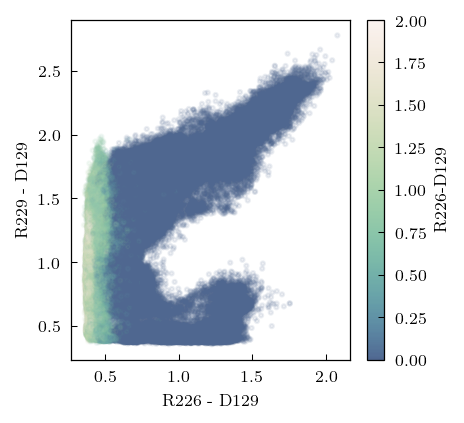

In [37]:
i, j, k = sb_ids[0], sb_ids[1], 6
# print(hb_labels[k])
hb = moving_average(moving_average(np.concatenate(arrs_old)[:, k], 10), 10)
plt.scatter(sb_arr[inds, i], sb_arr[inds, j], c=hb[inds], cmap=cm_seq, alpha=0.1)
plt.xlabel(sb_labels[i - 30])
plt.ylabel(sb_labels[j - 30])
cb = plt.colorbar(label=hb_labels[k])
cb.solids.set(alpha=1.)

In [55]:
importlib.reload(util)

<module 'util' from '/project/dinner/scguo/ci-vsd/notebooks/exploratory/../../python/util.py'>

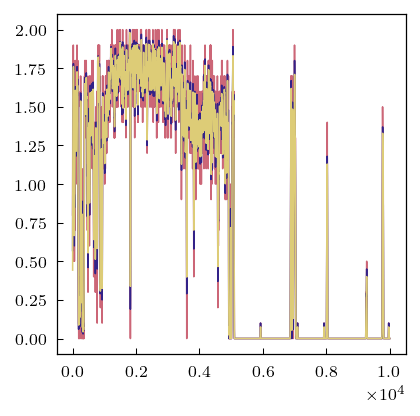

In [67]:
plt.plot(util.smooth_moving_average(arrs_old[0][:, 8], 10, 1))
plt.plot(util.smooth_moving_average(arrs_old[0][:, 8], 10, 2))
plt.plot(util.smooth_moving_average(arrs_old[0][:, 8], 10, 3))

[None]

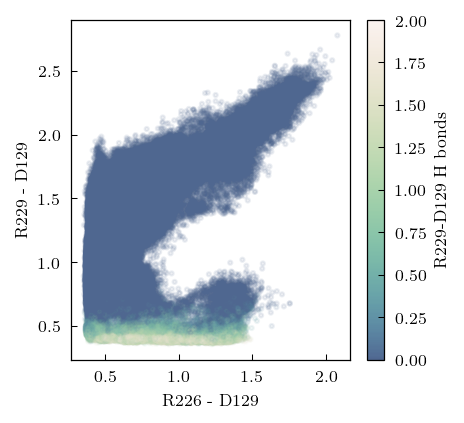

In [69]:
i, j, k = sb_ids[0], sb_ids[1], 9
# print(hb_labels[k])
# hb = moving_average(moving_average(np.concatenate(arrs_old)[:, k], 10), 10)
hb_trajs = util.smooth_moving_average([t[:, k] for t in arrs_old], 10, 2)
hb_arr = np.concatenate(hb_trajs)
plt.scatter(sb_arr[inds, i], sb_arr[inds, j], c=hb_arr[inds], cmap=cm_seq, alpha=0.1)
plt.xlabel(util.sb_label(i))
plt.ylabel(util.sb_label(j))
cb = plt.colorbar(label=f"{hb_labels[k]} H bonds")
cb.solids.set(alpha=1.)

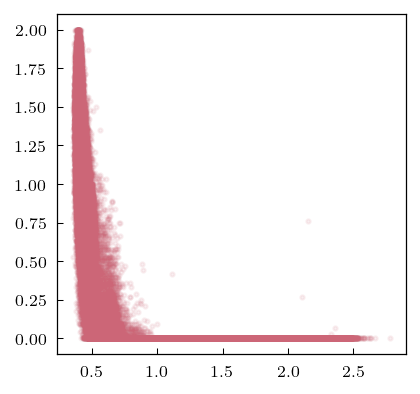

In [40]:
plt.scatter(sb_arr[inds, j], hb[inds], cmap=cm_seq, alpha=0.1)

Text(0, 0.5, 'R229-D129')

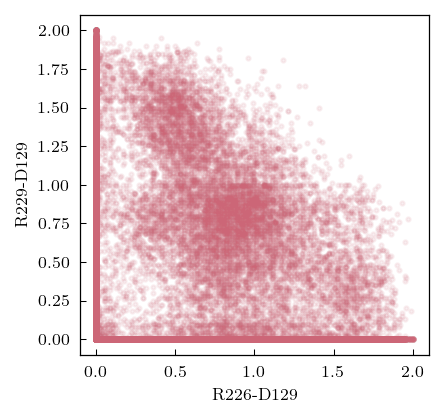

In [74]:
i, j = 6, 9

hb_trajsi = util.smooth_moving_average([t[:, i] for t in arrs_old], 10, 2)
hb_trajsj = util.smooth_moving_average([t[:, j] for t in arrs_old], 10, 2)
hb_arri = np.concatenate(hb_trajsi)
hb_arrj = np.concatenate(hb_trajsj)
plt.scatter(hb_arri[inds], hb_arrj[inds], cmap=cm_seq, alpha=0.1)
plt.xlabel(hb_labels[i])
plt.ylabel(hb_labels[j])
# cb = plt.colorbar(label=f"{hb_labels[k]} H bonds")
# cb.solids.set(alpha=1.)

[None]

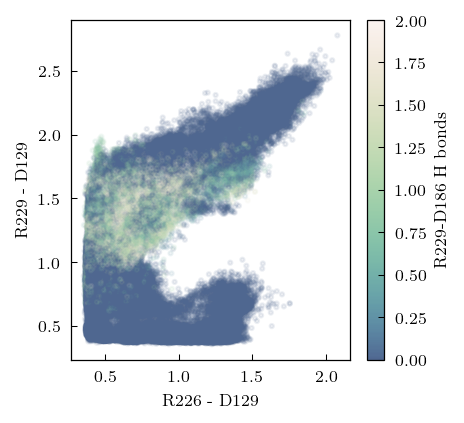

In [76]:
i, j, k = sb_ids[0], sb_ids[1], 11

hb_trajs = util.smooth_moving_average([t[:, k] for t in arrs_old], 10, 2)
hb_arr = np.concatenate(hb_trajs)
plt.scatter(sb_arr[inds, i], sb_arr[inds, j], c=hb_arr[inds], cmap=cm_seq, alpha=0.1)
plt.xlabel(util.sb_label(i))
plt.ylabel(util.sb_label(j))
cb = plt.colorbar(label=f"{hb_labels[k]} H bonds")
cb.solids.set(alpha=1.)

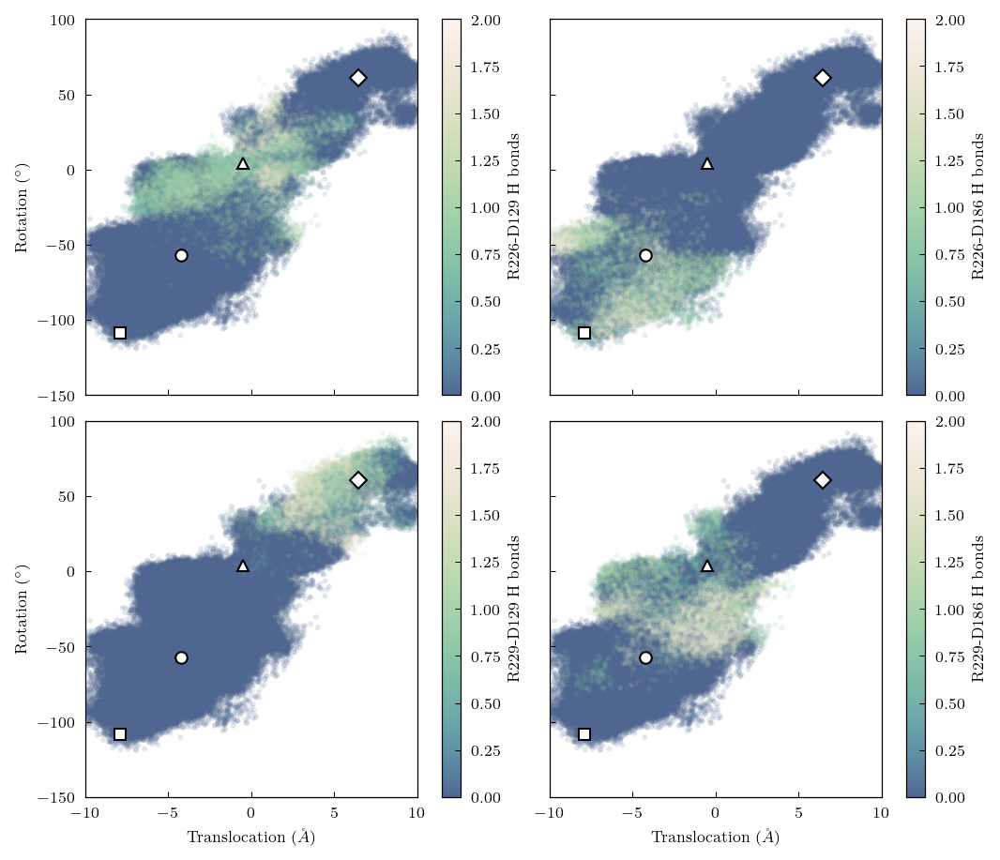

In [83]:
f, axs = plt.subplots(2, 2, figsize=(7, 6), constrained_layout=True, sharex=True, sharey=True)
for k, ax in zip((6, 8, 9, 11), axs.flat):
    hb_trajs = util.smooth_moving_average([t[:, k] for t in arrs_old], 10, 2)
    hb_arr = np.concatenate(hb_trajs)
    h = ax.scatter(cv_arr[inds, 0], cv_arr[inds, 1], c=hb_arr[inds], cmap=cm_seq, alpha=0.1)
    plotting.format_cvs(ax, ms=6)
    cb = plt.colorbar(h, ax=ax, label=f"{hb_labels[k]} H bonds")
    cb.solids.set(alpha=1.)
for ax in axs.flat:
    ax.label_outer()

# Committors